In [1]:
import GPy, numpy as np
%matplotlib inline
from matplotlib import pyplot as plt
from IPython.display import HTML
np.random.seed(1234)

In [2]:
from animate_gp import animate_kernel, plot_data, create_empty_ax, fill_grad

# Mauna-Loa

In [3]:
import GPy
from sklearn.datasets import fetch_mldata
data = fetch_mldata('mauna-loa-atmospheric-co2').data
61
X_mauna = data[:, [1]]
y_mauna = data[:, [0]]
k1 = GPy.kern.RBF(1, variance=5, lengthscale=100, name='Long term')
k2 = GPy.kern.RBF(1, 1, 90) * GPy.kern.StdPeriodic(1, variance=1,
    lengthscale=1.3, period=1)
k2.std_periodic.period.fix()
k2.name = "Seasonal"
k3 = GPy.kern.RatQuad(1, variance=1, lengthscale=1.2, power=.78, name='Medium term irregularities')
k4 = GPy.kern.RBF(1, variance=1, lengthscale=1, name='Noise')
k5 = GPy.kern.Bias(1, name='mean')
kernel = GPy.kern.Add([
    k1, k2, 
    k3, 
    #k4,
    k5])
m_mauna = GPy.models.GPRegression(X_mauna, y_mauna, kernel=kernel, normalizer=True)
m_mauna.likelihood.variance = .01
m_mauna.optimize(messages=1)

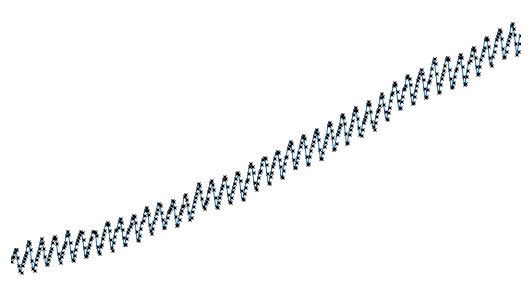

In [4]:
fig, ax = create_empty_ax()
ax.set_xlim(X_mauna.min(), X_mauna.max())
fig.tight_layout()
ax.plot(X_mauna, y_mauna, lw=1, )
ax.plot(X_mauna, y_mauna, lw=0, marker='x', markersize=3, color='k')
fig.savefig('mauna_loa_data.pdf')

In [5]:
X_mauna.min(), X_mauna.max()

(1959.0, 1997.91666667)

In [6]:
_X = np.linspace(1950, 2025, 1000)[:,None]
_mu, _K = m_mauna.predict_noiseless(_X, full_cov=True, kern=m_mauna.kern.Long_term.copy())

fig, ax = create_empty_ax()
ax.set_xlim(_X.min(), _X.max())
fig.tight_layout()
fill_grad(ax, _X, _mu, _K)
plot_data(ax, X_mauna, y_mauna)
anim = animate_kernel(fig, ax, _X, _mu, _K, 'mauna_loa_long_term.mp4', frames=100)
plt.close(fig)
jshtml = anim.to_jshtml()
HTML(jshtml)

In [7]:
_X = np.linspace(1950, 2025, 1000)[:,None]
_mu, _K = m_mauna.predict_noiseless(_X, full_cov=True, kern=m_mauna.kern.Long_term.copy()+m_mauna.kern.Seasonal.copy())

fig, ax = create_empty_ax()
ax.set_xlim(_X.min(), _X.max())
fig.tight_layout()
fill_grad(ax, _X, _mu, _K)
plot_data(ax, X_mauna, y_mauna)
anim = animate_kernel(fig, ax, _X, _mu, _K, 'mauna_loa_seasonal.mp4', frames=100)
plt.close(fig)
jshtml = anim.to_jshtml()
HTML(jshtml)

In [8]:
_X = np.linspace(1950, 2025, 1000)[:,None]
_mu, _K = m_mauna.predict_noiseless(_X, full_cov=True, kern=m_mauna.kern.Medium_term_irregularities.copy()+m_mauna.kern.Long_term.copy()+m_mauna.kern.Seasonal.copy())

fig, ax = create_empty_ax()
ax.set_xlim(_X.min(), _X.max())
fig.tight_layout()
fill_grad(ax, _X, _mu, _K)
plot_data(ax, X_mauna, y_mauna)
anim = animate_kernel(fig, ax, _X, _mu, _K, 'mauna_loa_medium.mp4', frames=100)
plt.close(fig)
jshtml = anim.to_jshtml()
HTML(jshtml)

In [9]:
_X = np.linspace(1950, 2025, 1000)[:,None]
_mu, _K = m_mauna.predict_noiseless(_X, full_cov=True)

fig, ax = create_empty_ax()
ax.set_xlim(_X.min(), _X.max())
fig.tight_layout()
fill_grad(ax, _X, _mu, _K)
plot_data(ax, X_mauna, y_mauna)
anim = animate_kernel(fig, ax, _X, _mu, _K, 'mauna_loa_all.mp4', frames=100)
plt.close(fig)
jshtml = anim.to_jshtml()
HTML(jshtml)